<a href="https://colab.research.google.com/github/Nadiakhoo/MachineLearning/blob/main/Assignment2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Environment Setup:
This notebook is intended to be run on Google Colab. You may complete the tasks offline, but at your own risk.

## Add dataset shortcut from your Google Account
Because of the size of the datasets, we are providing the files from Google Drive.

To access the provided data, go to [this link](https://drive.google.com/drive/folders/1_5LoxbmWDKPKi91Z_HmQn4TFoTtXnxQM?usp=sharing) and click "COMP4211_dataset->Organise->Add shortcut" to save a shortcut in your Google Drive "My Drive" folder (or any specific path in your google drive)

Mount the dataset by the following code (requires authorization):

In [ ]:
from google.colab import drive
import os
drive.mount('/content/drive')
data_path = "/content/drive/My Drive/COMP4211_dataset"
vgg_path = os.path.join(data_path, 'vgg19.npz')

pacs_zip = os.path.join(data_path, 'classify/pacs-dataset.zip')
wikiart_zip = os.path.join(data_path, 'wikiart.zip')
coco_zip = os.path.join(data_path, 'COCO.zip')

pacs_path = "classify"
wikiart_path = "wikiart"
coco_path = "COCO"

Mounted at /content/drive


To speed up the image loading, we unzip the training image datasets to the Google Colab VM rather than access it directly from Google Drive.

In [ ]:
!unzip "$wikiart_zip" > /dev/null 2>&1
!unzip "$coco_zip" > /dev/null 2>&1

(Tip: If you're only doing the second task, skip the above code to save a bit of time)

In [ ]:
# Put the PACS files in a subfolder
!mkdir -p "$pacs_path"
!unzip "$pacs_zip" -d "$pacs_path" > /dev/null 2>&1

## Preparation

This section contains imports and functions that will be used in the later tasks. Some of them are provided.

### Imports

In [ ]:
# Basic Libraries
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns

# Important submodules and functions from Tensorflow (and Keras)
from tensorflow.keras.layers import Input, Dense, Conv2D, UpSampling2D, Reshape, MaxPooling2D, Lambda, Layer, GlobalAveragePooling2D
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.preprocessing.image import array_to_img

# Image handling and visualization
from matplotlib import pyplot as plt
from matplotlib import image as mpimg
from IPython.display import display
from tqdm.notebook import tqdm
import cv2

# Other utility
import datetime
import psutil

# Module settings:
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # This will hide all TensorFlow messages, except for errors.
tf.get_logger().setLevel('ERROR')  # This sets TensorFlow logger to only output error messages.

### Utility Functions

**Preprocessing and Deprocessing Images**: In style transfer, images often need to be adjusted before and after passing through the model. The `preprocess` function converts images from RGB (used in most image formats) to BGR (used by the model) and normalizes pixel values by subtracting a mean value. This step helps in aligning the image data with the format expected by the VGG network, which our style transfer model is based on. Conversely, the `deprocess` function reverses these adjustments, converting the image back from BGR to RGB and adding the mean pixel values, making the output image suitable for viewing.

**Loading Images**: The `get_image` function reads an image from the disk, converts it to the RGB format, and optionally resizes it. This function is crucial for preparing your dataset for training or evaluation. It ensures that all images fed into the model are consistent in size and format.

**Finding Images**: The `find_images` function takes a directory path and a file type, and finds (recursively) all files within the directory that matches the file type. This is used for obtaining the images in the WikiArt and COCO dataset, as the images are put in different folders.

In [ ]:
# Prepares an image for the model by converting RGB to BGR and subtracting the mean pixel values.
def preprocess(x):
    img = tf.reverse(x, axis=[-1])  # RGB to BGR
    img -= np.array([103.939, 116.779, 123.68])  # Subtract mean pixel value
    return img

# Converts the output of the model back to a viewable image by adding mean pixel values and converting BGR to RGB.
def deprocess(x):
    img = x + np.array([103.939, 116.779, 123.68])  # Add mean pixel value
    img = tf.reverse(img, axis=[-1])  # BGR to RGB
    img = tf.clip_by_value(img, 0.0, 255.0)  # Ensure pixel value range is valid
    return img

# Loads an image from disk, optionally resizes it, and prepares it for the model.
def get_image(img_path, resize=True, shape=(256,256)):
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR (OpenCV default) to RGB
    if resize:
        image = cv2.resize(image, shape)  # Resize image
    image = image.astype(np.float32)  # Convert to float32 for model compatibility
    return image

# Finds and returns a list of images (files) within a directory path that matches a certain file type.
def find_images(dir_path, file_type):
    image_paths = []

    for root, _, files in os.walk(dir_path):
        for file in files:
            if f'.{file_type}' in file:
                image_paths.append(os.path.join(root, file))

    return image_paths


### Datasets

This programming assignment requires 2 types of dataset, both used for loading images on-demand:

- `ImageDataset`, a dataset class that finds and collects image files within a given directory, and loads them for training. A single sample should only include the image bitmap (preprocessed using the above functions).
- `ClassificationDataset`, a dataset class that references a given `.tsv` file for file names and labels, and loads the images from the given directory along with the class label. A single sample should include the processed image bitmap, along with its class label in one-hot encoding.

In [ ]:
# [C1]
class ImageDataset:
    def __init__(self, dir_path, batch_size=8, file_type="jpg", random_state = 4211):
        self.dir_path = dir_path
        self.batch_size = batch_size
        self.file_type = file_type
        self.random_state = 4211

        self.ds_pointer = 0
        self.image_paths = find_images(self.dir_path, self.file_type)

    def reset_pointer(self, seed=None):
        self.ds_pointer = 0
        if seed is not None:
            np.random.seed(seed)

    def get_batch(self):
        if (self.ds_pointer + self.batch_size) > len(self.image_paths):
            self.reset_pointer()
            return None

        end_point = self.ds_pointer + self.batch_size
        get_batch_paths = self.image_paths[self.ds_pointer:end_point]
        get_batch_images = [get_image(img_path) for img_path in get_batch_paths]
        get_batch_images = preprocess(np.array(get_batch_images))
        self.ds_pointer += self.batch_size

        if self.ds_pointer >= len(self.image_paths):
            self.reset_pointer()
        return get_batch_images

    def __len__(self):
        return len(self.image_paths)

In [ ]:
data_coco = ImageDataset(coco_path)
print(f"Number of images in COCO dataset: {len(data_coco)}")

data_wikiart = ImageDataset(wikiart_path)
print(f"Number of images in WikiArt dataset: {len(data_wikiart)}")

Number of images in COCO dataset: 3557
Number of images in WikiArt dataset: 7492


In [ ]:
# Here's a preview of what the TSV would look like (top 10 rows):
!cat "$pacs_path/train-data.tsv" | head -n 10

pic_2524.jpg	sketch	dog
pic_888.jpg	sketch	dog
pic_1279.jpg	sketch	dog
pic_2694.jpg	sketch	dog
pic_79.jpg	sketch	dog
pic_650.jpg	sketch	dog
pic_2095.jpg	sketch	dog
pic_481.jpg	sketch	dog
pic_332.jpg	sketch	dog
pic_1417.jpg	sketch	dog


In [ ]:
# [C2]
class ClassificationDataset:
    def __init__(self, tsv_path, dir_path, batch_size=8, random_state=4211):
        self.tsv_path = tsv_path
        self.dir_path = dir_path
        self.batch_size = batch_size
        self.random_state = 4211

        self.ds_pointer = 0
        self.image_paths = find_images(dir_path, 'jpg')
        self.data = self._process_tsv(tsv_path, dir_path)
        self._shuffle_data()

        # one-hot encodings
        all_labels = self.data['label'].unique()
        self.one_hot_encoder = pd.get_dummies(all_labels)
        self.one_hot_encoder.index = all_labels

    def _process_tsv(self, tsv_path, dir_path):
        data = pd.read_csv(tsv_path, sep ='\t', header = None, names = ['file_name', 'style', 'label'])
        data['file_name'] = data['file_name'].apply(lambda x: os.path.join(dir_path, x))
        return data

    def add_data(self, tsv_path, dir_path):
        additional_data = self._process_tsv(tsv_path, dir_path)
        self.data = pd.concat([self.data, additional_data], ignore_index=True)
        self.image_paths = pd.concat([self.image_paths, find_images(dir_path, 'jpg')])
        self._shuffle_data()

    def reset_pointer(self, seed=None):
        if seed is not None:
            np.random.seed(seed)
        self.ds_pointer = 0
        self._shuffle_data()

    def get_batch(self):
        if self.ds_pointer + self.batch_size > len(self.data):
            self.reset_pointer()
            return None

        end_point = min(self.ds_pointer + self.batch_size, len(self.data))
        batch_data = self.data.iloc[self.ds_pointer:end_point]
        get_batch_images = [get_image(filepath) for filepath in batch_data['file_name']]
        get_batch_images = preprocess(np.array(get_batch_images))

        # one-hot encoding for label
        batch_labels = self.one_hot_encoder.loc[batch_data['label']].values

        self.ds_pointer += self.batch_size
        return get_batch_images, batch_labels

    def __len__(self):
        return len(self.data)

    def _shuffle_data(self):
        self.data = self.data.sample(frac=1, random_state=self.random_state).reset_index(drop=True)


In [ ]:
data_pacs_train = ClassificationDataset(os.path.join(pacs_path, 'train-data.tsv'), os.path.join(pacs_path, 'train-files'), batch_size=60)
print(f"Number of images in PACS train dataset: {len(data_pacs_train)}")

data_pacs_test = ClassificationDataset(os.path.join(pacs_path, 'test-data.tsv'), os.path.join(pacs_path, 'test-files'), batch_size=8)
print(f"Number of images in PACS test dataset: {len(data_pacs_test)}")

Number of images in PACS train dataset: 1641
Number of images in PACS test dataset: 2723


## Part 1: Style Transfer


### Model Components

In [ ]:
class AdaIN(Layer):
    """
    Adaptive Instance Normalization (AdaIN) layer with controllable style transfer intensity.
    This layer adjusts the mean and variance of the content features to match those of the style features,
    then blends the result with the original content features based on a specified alpha value.
    """
    def __init__(self, epsilon=1e-5, **kwargs):
        super(AdaIN, self).__init__(**kwargs)
        self.epsilon = epsilon  # Small constant to avoid division by zero.

    def call(self, inputs):
        content, style, alpha = inputs

        # Compute mean and variance for content and style features.
        meanC, varC = tf.nn.moments(content, [1, 2], keepdims=True)
        meanS, varS = tf.nn.moments(style, [1, 2], keepdims=True)

        # Standard deviation is the square root of variance, adjusted with epsilon for numerical stability.
        sigmaC = tf.sqrt(varC + self.epsilon)
        sigmaS = tf.sqrt(varS + self.epsilon)

        # Perform AdaIN by normalizing content features and scaling them by style's standard deviation and mean.
        normalized_content = (content - meanC) / sigmaC
        stylized_content = normalized_content * sigmaS + meanS

        # Blend stylized content with original content based on alpha.
        blended_content = alpha * stylized_content + (1 - alpha) * content
        return blended_content

In [ ]:
def build_vgg19_enc(input_shape, weights_path):
    weights = np.load(weights_path)

    # [C3] Create vgg19 structure
    model = Sequential()

    model.add(Conv2D(64, (3, 3), activation = 'relu', padding = 'same', input_shape = input_shape, name = 'conv1_1'))
    model.add(Conv2D(64, (3, 3), activation = 'relu', padding = 'same', name = 'conv1_2'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2), name = 'pool1'))

    model.add(Conv2D(128, (3, 3), activation = 'relu', padding = 'same', name = 'conv2_1'))
    model.add(Conv2D(128, (3, 3), activation = 'relu', padding = 'same', name = 'conv2_2'))
    model.add(MaxPooling2D((2, 2), strides = (2, 2), name = 'pool2'))

    model.add(Conv2D(256, (3, 3), activation = 'relu', padding = 'same', name = 'conv3_1'))
    model.add(Conv2D(256, (3, 3), activation = 'relu', padding = 'same', name = 'conv3_2'))
    model.add(Conv2D(256, (3, 3), activation = 'relu', padding = 'same', name = 'conv3_3'))
    model.add(Conv2D(256, (3, 3), activation = 'relu', padding = 'same', name = 'conv3_4'))

    model.add(MaxPooling2D((2, 2), strides = (2, 2), name = 'pool3'))
    model.add(Conv2D(512, (3, 3), activation = 'relu', padding = 'same', name = 'conv4_1'))

    # [C4] Load in weights and freeze the model
    # weights = np.load(weights_path)
    idx = 0
    for layer in model.layers:
        if isinstance(layer, Conv2D):
            weights_key = f'arr_{idx}'
            biases_key = f'arr_{idx + 1}'
            kernel = weights[weights_key]
            kernel = kernel.transpose([2, 3, 1, 0]).astype(np.float32)
            bias = weights[biases_key].astype(np.float32)
            layer.set_weights([kernel, bias])
            idx += 2

    model.trainable = False
    return model

def build_vgg19_relus(vgg19):
    relus = ['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1']
    features = [vgg19.get_layer(relu).output for relu in relus]
    vgg19_relus = Model(inputs=vgg19.input, outputs=features)
    vgg19_relus.trainable = False
    return vgg19_relus

# [C5]
def build_decoder(input_shape):
    return Sequential([
        Conv2D(256, (3, 3), activation = 'relu', padding = 'same', input_shape = input_shape),
        UpSampling2D((2, 2)),
        Conv2D(256, (3, 3), activation = 'relu', padding = 'same'),
        Conv2D(256, (3, 3), activation = 'relu', padding = 'same'),
        Conv2D(256, (3, 3), activation = 'relu', padding = 'same'),
        UpSampling2D((2, 2)),
        Conv2D(128, (3, 3), activation = 'relu', padding = 'same'),
        Conv2D(128, (3, 3), activation = 'relu', padding = 'same'),
        UpSampling2D((2, 2)),
        Conv2D(64, (3, 3), activation = 'relu', padding = 'same'),
        Conv2D(64, (3, 3), activation = 'relu', padding = 'same'),
        Conv2D(3, (3, 3), padding = 'same')])


def build_model(encoder, decoder, input_shape):
    content = Input(shape=input_shape, name='content')
    style = Input(shape=input_shape, name = 'style')
    alpha = Input(shape=(1,), name='alpha')

    enc_content = encoder(content)
    enc_style = encoder(style)

    adain = AdaIN()([enc_content, enc_style, alpha])

    out = decoder(adain)

    return Model(inputs=[content, style, alpha], outputs=[out, adain])


In [ ]:
def get_loss(encoder, vgg19_relus, epsilon=1e-5, style_weight=1.0):

    def loss(y_true, y_pred):
        out, adain = y_pred[0], y_pred[1]

        # Encode output and compute content_loss
        out = deprocess(out)
        out = preprocess(out)
        enc_out = encoder(out)
        content_loss = tf.reduce_sum(tf.reduce_mean(tf.square(enc_out - adain), axis=[1, 2]))

        # Compute style loss from vgg relus
        style = y_true[1]
        style_featues = vgg19_relus(style)
        gen_features = vgg19_relus(out)
        style_layer_loss = []
        for enc_style_feat, enc_gen_feat in zip(style_featues, gen_features):
            meanS, varS = tf.nn.moments(enc_style_feat, [1, 2])
            meanG, varG = tf.nn.moments(enc_gen_feat,   [1, 2])

            sigmaS = tf.sqrt(varS + epsilon)
            sigmaG = tf.sqrt(varG + epsilon)

            l2_mean  = tf.reduce_sum(tf.square(meanG - meanS))
            l2_sigma = tf.reduce_sum(tf.square(sigmaG - sigmaS))

            style_layer_loss.append(l2_mean + l2_sigma)

        style_loss = tf.reduce_sum(style_layer_loss)

        # Compute the total loss
        weighted_style_loss = style_weight * style_loss
        total_loss = content_loss + weighted_style_loss
        return total_loss, content_loss, weighted_style_loss

    return loss

### Training Routine

In [ ]:
# [C6]
def part1_train(model, content_ds, style_ds, loss_fn, n_epochs = 10, save_interval = 10, save_path=None, load_path=None):
    # Initialize the Optimizer
    optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4, weight_decay = 5e-5)

    # Calculate the number of batches per epoch
    n_batches = len(content_ds) // content_ds.batch_size

    # Initialize other things
    process = psutil.Process(os.getpid())
    alpha = 1.0

    # Load weights if provided
    if load_path:
        model.load_weights(load_path)

    # Run for n epochs
    for e in range(1, n_epochs+1):
        pbar = tqdm(total=n_batches)
        # Reset Dataset Iterators
        content_ds.reset_pointer()
        style_ds.reset_pointer()

        # Define Loss Metrics. To be updated in each batch
        losses = {"total": 0.0, "content": 0.0, "style": 0.0}

        # Run for all batches
        for i in range(n_batches):
            # Fetch Training Batches
            content_batch = content_ds.get_batch()
            style_batch = style_ds.get_batch()

            # Execute Batch Training
            # Tip: Use tf.GradientTape() when computing the loss, to obtain the gradient.
            with tf.GradientTape() as tape:
                out, adain = model([content_batch, style_batch, alpha])
                loss, content_loss, style_loss = loss_fn([content_batch, style_batch], [out, adain])

            grads = tape.gradient(loss, model.trainable_weights)
            optimizer.apply_gradients(zip(grads, model.trainable_weights))

            # Update Loss Metrics
            total_updated = losses["total"] * i + loss.numpy()
            losses["total"] = total_updated/ (i+1)

            content_updated = losses["content"] * i + content_loss.numpy()
            losses["content"] = content_updated/ (i+1)

            style_updated = losses["style"] * i + style_loss.numpy()
            losses["style"] = style_updated/(i+1)

            # Visualize loss during training
            string = "".join([f"{key} loss: {value:.3f}\t" for key, value in losses.items()])
            pbar.set_description(f"Epoch {e}/{n_epochs}\t" + string)
            pbar.update(1)

        # In case the session ends before the training is done, perform a save on the model from time to time:
        print(f"Epoch {e}/{n_epochs}\t" + string)
        if e % save_interval == 0:
            if os.path.exists(save_path):
                model.save(save_path)

### Model setup

In [ ]:
def part1_prepare_datasets():
    #####
    # MODIFY SETTINGS HERE
    #####
    BATCH_SIZE = 16 # Recommended according to the Google Colab T4 GPU

    content_ds = ImageDataset(coco_path, batch_size=BATCH_SIZE)
    style_ds = ImageDataset(wikiart_path, batch_size=BATCH_SIZE)

    return content_ds, style_ds

def part1_setup():
    #####
    # MODIFY SETTINGS HERE
    #####
    STYLE_WEIGHT = 2.0
    EPSILON = 1e-5

    INPUT_SHAPE = (None, None, 3) # We accept any image size

    # Build model
    vgg19 = build_vgg19_enc(INPUT_SHAPE, vgg_path)  # encoder
    decoder = build_decoder(vgg19.output.shape[1:])  # input shape == encoder output shape
    decoder.summary()
    model = build_model(vgg19, decoder, INPUT_SHAPE)

    # Get loss
    vgg19_relus = build_vgg19_relus(vgg19)
    loss = get_loss(vgg19, vgg19_relus, epsilon=EPSILON, style_weight=STYLE_WEIGHT)

    return model, loss

In [ ]:
content_ds, style_ds = part1_prepare_datasets()

In [ ]:
model, loss = part1_setup()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, None, None, 256)   1179904   
                                                                 
 up_sampling2d (UpSampling2  (None, None, None, 256)   0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, None, None, 256)   590080    
                                                                 
 conv2d_2 (Conv2D)           (None, None, None, 256)   590080    
                                                                 
 conv2d_3 (Conv2D)           (None, None, None, 256)   590080    
                                                                 
 up_sampling2d_1 (UpSamplin  (None, None, None, 256)   0         
 g2D)                                                 

We can now start the training:

In [ ]:
PART1_SAVE_PATH = '/content/drive/MyDrive/COMP4211_Models/model.h5'
PART1_LOAD_PATH = '/content/drive/MyDrive/COMP4211_Models/model.h5'

In [ ]:
# keeping commented to prevent rerunning
# part1_train(model, content_ds, style_ds, loss, n_epochs=1, save_path=PART1_SAVE_PATH)

  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 1/1	total loss: 78310.700	content loss: 28945.914	style loss: 49364.786	


In [ ]:
# keeping commented to prevent rerunning
# part1_train(model, content_ds, style_ds, loss, n_epochs=19, save_path=PART1_SAVE_PATH, load_path=PART1_LOAD_PATH)

  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 1/19	total loss: 42744.187	content loss: 23027.611	style loss: 19716.575	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 2/19	total loss: 32489.489	content loss: 18951.277	style loss: 13538.212	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 3/19	total loss: 28027.939	content loss: 16677.745	style loss: 11350.194	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 4/19	total loss: 25357.718	content loss: 15189.783	style loss: 10167.935	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 5/19	total loss: 23371.076	content loss: 14122.431	style loss: 9248.645	
Model saved at /content/drive/MyDrive/COMP4211_Models/model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 6/19	total loss: 22202.606	content loss: 13413.935	style loss: 8788.671	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 7/19	total loss: 21167.744	content loss: 12845.031	style loss: 8322.713	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 8/19	total loss: 20293.462	content loss: 12367.623	style loss: 7925.839	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 9/19	total loss: 19744.743	content loss: 12030.757	style loss: 7713.986	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 10/19	total loss: 19156.550	content loss: 11715.963	style loss: 7440.587	
Model saved at /content/drive/MyDrive/COMP4211_Models/model.h5


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 11/19	total loss: 18555.109	content loss: 11392.033	style loss: 7163.077	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 12/19	total loss: 18113.819	content loss: 11140.352	style loss: 6973.467	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 13/19	total loss: 17724.449	content loss: 10922.601	style loss: 6801.848	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 14/19	total loss: 17423.395	content loss: 10740.975	style loss: 6682.420	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 15/19	total loss: 17145.316	content loss: 10579.024	style loss: 6566.292	
Model saved at /content/drive/MyDrive/COMP4211_Models/model.h5


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 16/19	total loss: 16795.991	content loss: 10399.547	style loss: 6396.445	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 17/19	total loss: 16625.063	content loss: 10281.824	style loss: 6343.238	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 18/19	total loss: 16402.154	content loss: 10151.519	style loss: 6250.635	


  0%|          | 0/222 [00:00<?, ?it/s]

Epoch 19/19	total loss: 16133.574	content loss: 10014.939	style loss: 6118.635	


Note: Due to the limited computing time available in Colab, it may be a good idea to divide the training into different sessions, by saving and loading the model weights in your Google Drive.  

Do not save the weights outside the drive or they will be deleted after the session ends!

### Inference

In [ ]:
# [C7]
def part1_inference(model_path, content_path, style_path, alpha):
  model = load_model(model_path, custom_objects={'AdaIN': AdaIN})

  # Get content image
  content_image = get_image(content_path,resize=False)
  content_image = preprocess(content_image)

  # Get style image
  style_image = get_image(style_path)
  style_image = preprocess(style_image)

  # Set alpha Value
  alpha_tensor = tf.constant(alpha, shape=(1,), dtype=tf.float32)

  # Do inference
  output_raw, _ = model.predict([content_image[None, ...], style_image[None, ...], alpha_tensor[None, ...]])
  output_array = output_raw.squeeze()

  # Convert output array to image
  y = deprocess(output_array)
  img = array_to_img(y)

  # Display the image in the Notebook
  display(img)

In [ ]:
ALPHA = 0.75

1/1 [==============================] - 8s 8s/step


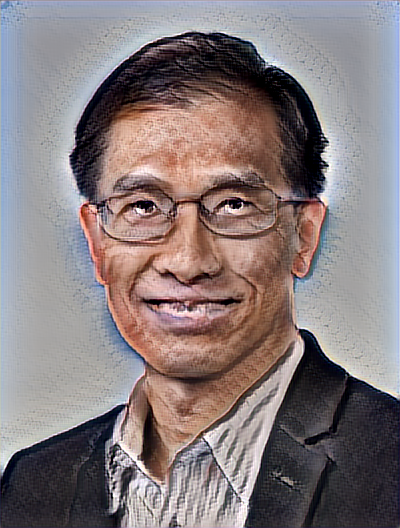

In [ ]:
ALPHA = 0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/dyyeung.jpg'
STYLE_PATH = 'wikiart/Analytical_Cubism/juan-gris_portrait-of-maurice-raynal-1911.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 27s 27s/step


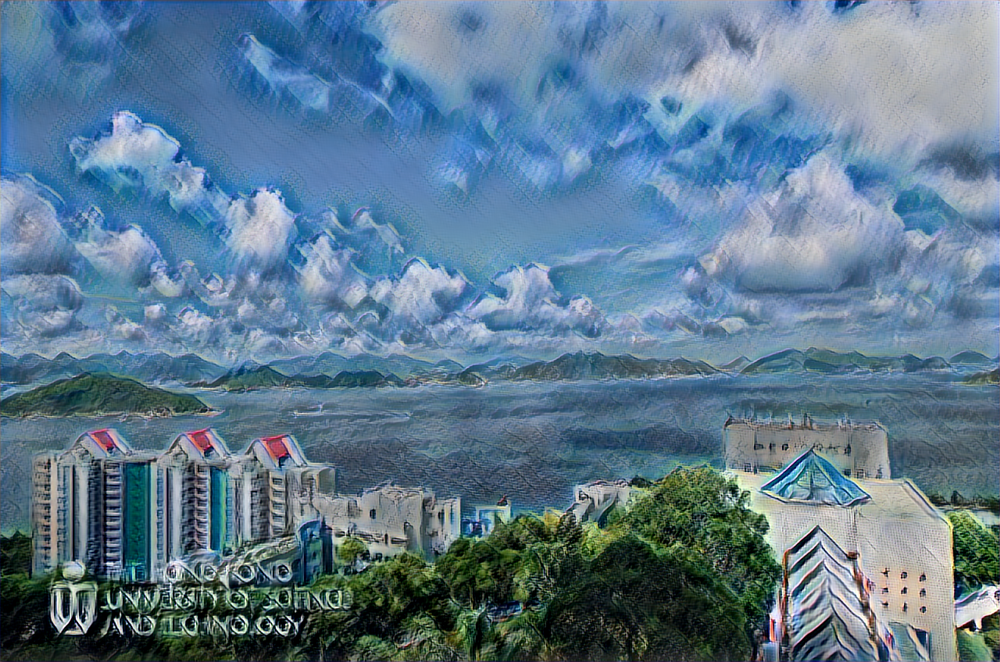

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/7.jpeg'
STYLE_PATH = '/content/drive/My Drive/COMP4211_dataset/Extra_styles/the-starry-night.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 36s 36s/step


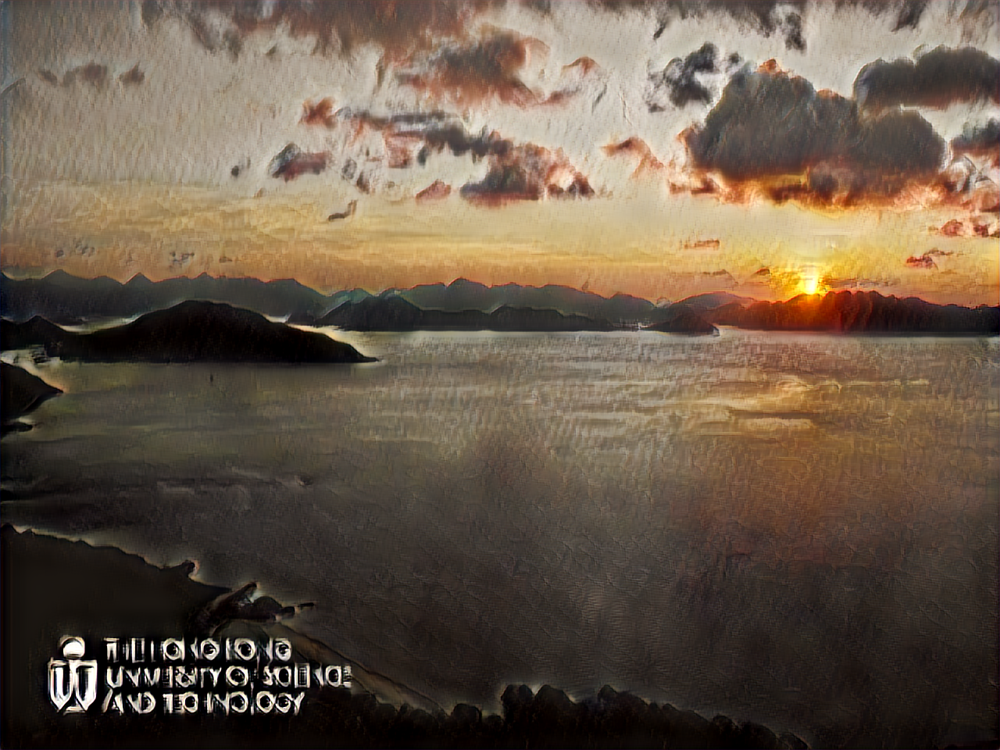

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/5.jpg'
STYLE_PATH = 'wikiart/Baroque/adriaen-brouwer_interior-of-a-tavern.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 23s 23s/step


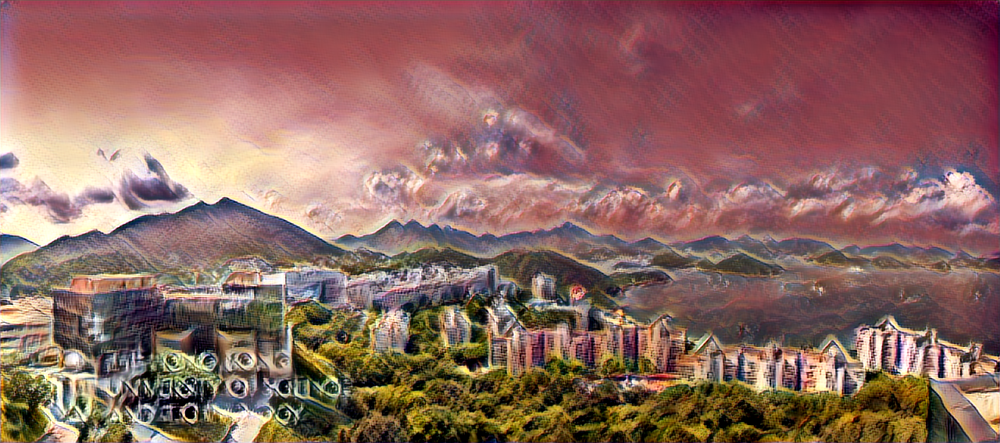

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/1.jpg'
STYLE_PATH = 'wikiart/New_Realism/john-french-sloan_girl-back-to-the-piano-1932.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 22s 22s/step


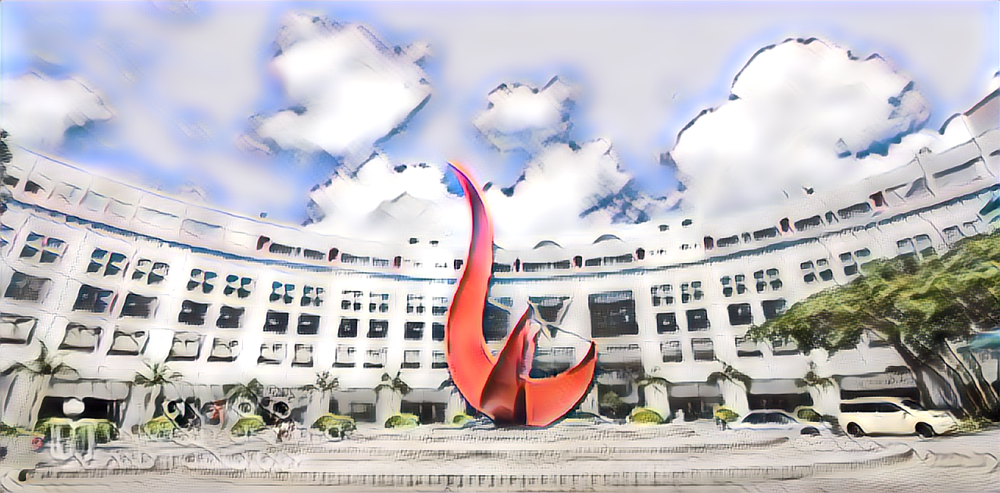

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/3.jpg'
STYLE_PATH = 'wikiart/Pop_Art/derek-boshier_plan-ii-1972.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 33s 33s/step


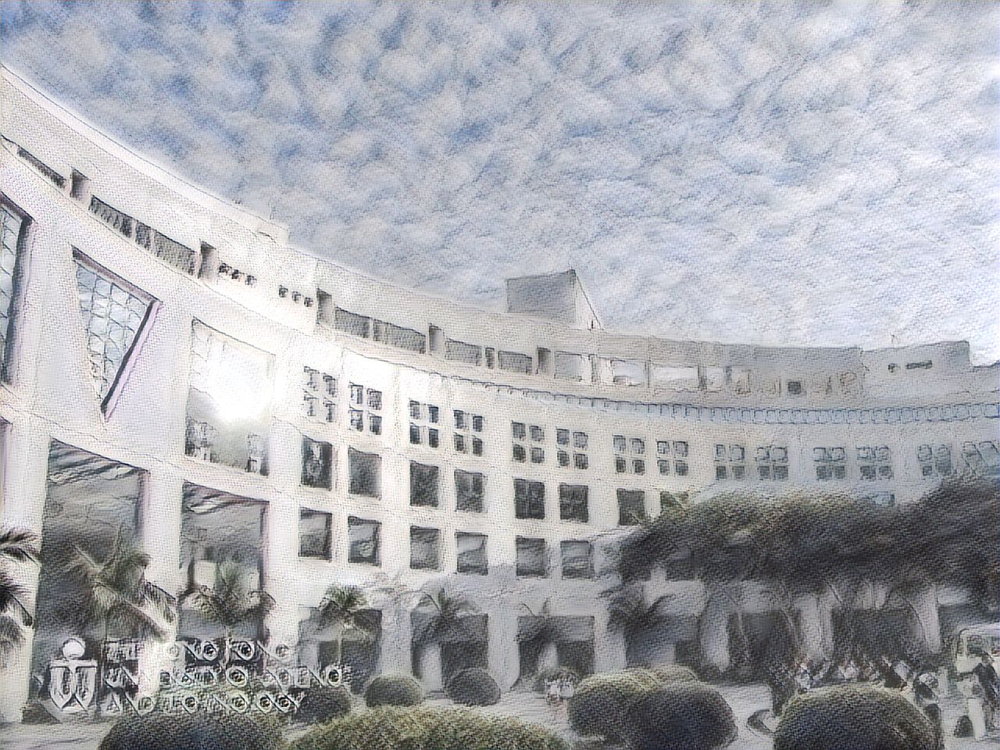

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/13.jpeg'
STYLE_PATH = 'wikiart/Minimalism/fernando-calhau_unknown-title-1.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 31s 31s/step


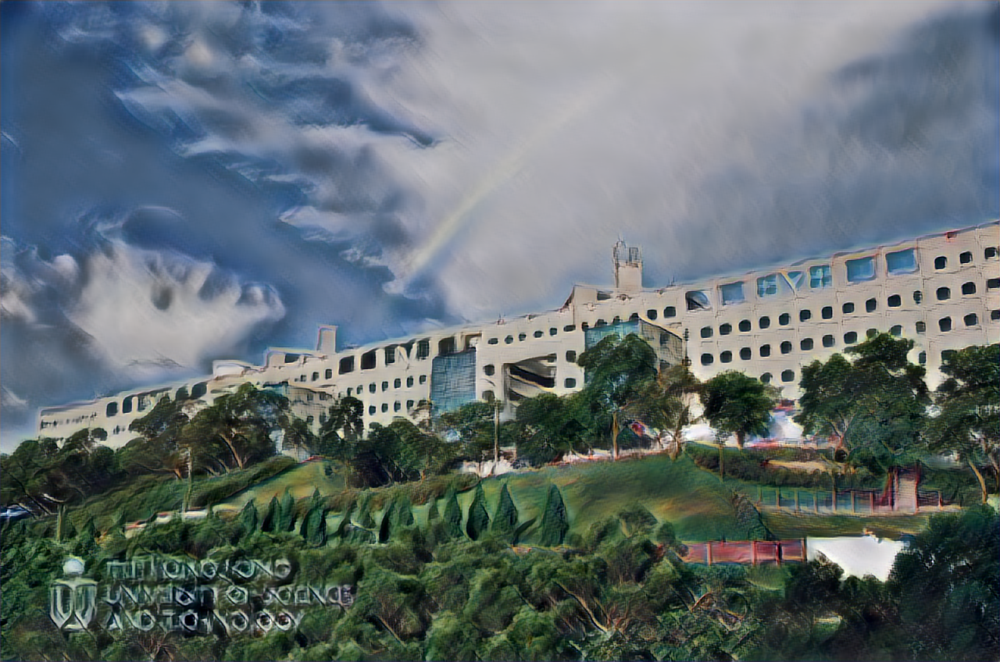

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/12.jpeg'
STYLE_PATH = 'wikiart/Rococo/joshua-reynolds_mrs-turnour-1757.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 33s 33s/step


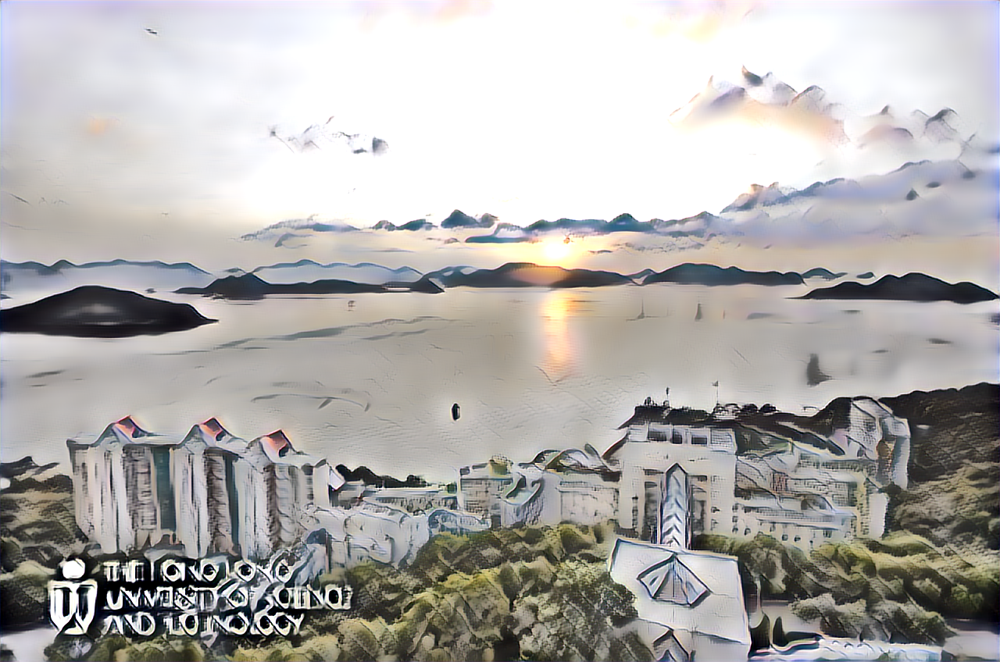

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/2.jpg'
STYLE_PATH = 'wikiart/Pop_Art/derek-boshier_plan-ii-1972.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 30s 30s/step


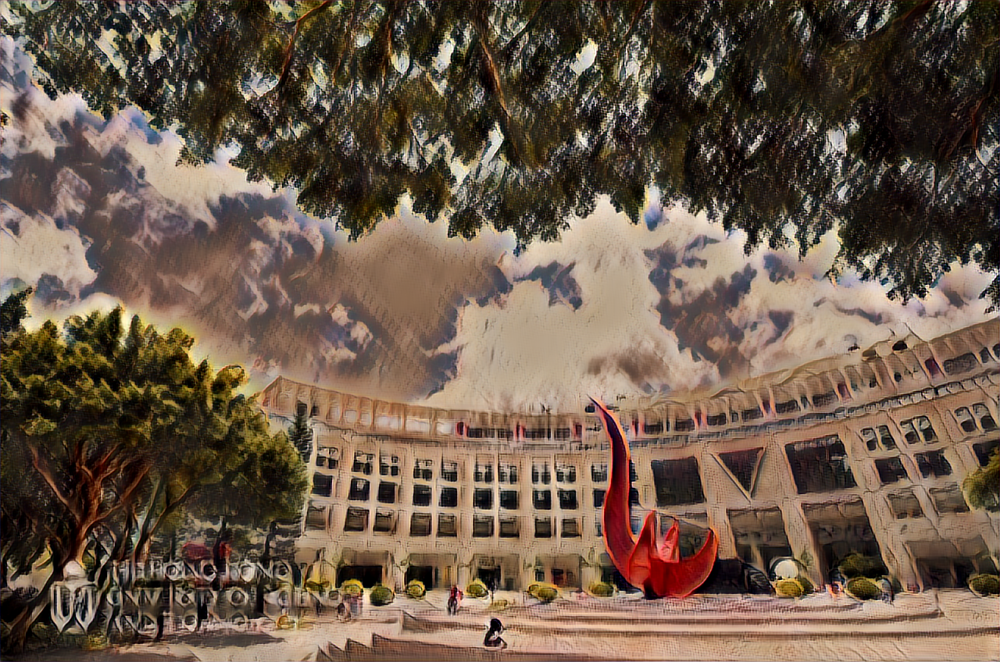

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/9.jpeg'
STYLE_PATH = 'wikiart/Romanticism/theodore-chasseriau_the-tepidarium-1853.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

1/1 [==============================] - 30s 30s/step


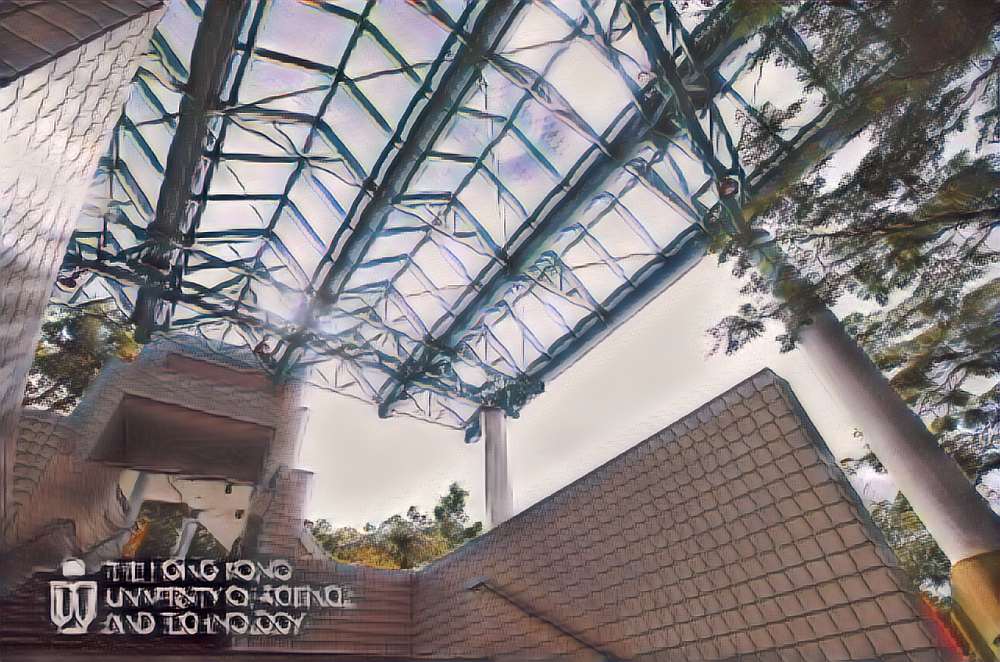

In [ ]:
ALPHA=0.75
MODEL_PATH = PART1_SAVE_PATH

CONTENT_PATH = '/content/drive/My Drive/COMP4211_dataset/HKUST/10.jpeg'
STYLE_PATH = 'wikiart/Ukiyo_e/katsushika-hokusai_the-pontoon-bridge-at-sano-in-the-province-of-kozuka.jpg'
part1_inference(MODEL_PATH, CONTENT_PATH, STYLE_PATH, ALPHA)

## Part 2: Classification Task

The second part of this assignment is a Classification Task, but with an unideal training dataset.

This task uses the PACS dataset (an image dataset with images of different categories and in different styles), but modified to have an abnormal distribution between styles and categories.

### Analyzing the dataset

Before we start the classification task, let's load and obtain some basic info about our training dataset.

In [ ]:
def part2_prepare_datasets():
    #####
    # MODIFY SETTINGS HERE
    #####
    BATCH_SIZE = 50 # my gpu keeps running out
    TRAIN_DS_PATH = os.path.join(pacs_path, "train-files/")
    TRAIN_TSV_PATH = os.path.join(pacs_path, "train-data.tsv")
    TEST_DS_PATH = os.path.join(pacs_path, "test-files/")
    TEST_TSV_PATH = os.path.join(pacs_path, "test-data.tsv")

    train_ds = ClassificationDataset(TRAIN_TSV_PATH, TRAIN_DS_PATH, batch_size = BATCH_SIZE)
    test_ds = ClassificationDataset(TEST_TSV_PATH, TEST_DS_PATH, batch_size = BATCH_SIZE)

    return train_ds, test_ds

train_ds, test_ds = part2_prepare_datasets()

Find out the distribution of images in diferent styles and categories:

In [ ]:
# [C8]
def part2_tally_samples(dataset):
    tally = dataset.data.groupby(['style', 'label']).size().reset_index(name = 'count')
    return tally

part2_tally_samples(train_ds)

,style,label,count
0,art_painting,dog,13
1,art_painting,elephant,13
2,art_painting,giraffe,231
3,art_painting,guitar,10
4,art_painting,horse,180
5,art_painting,house,11
6,art_painting,person,11
7,cartoon,dog,10
8,cartoon,elephant,13
9,cartoon,giraffe,12


<Axes: ylabel='stylelabel'>

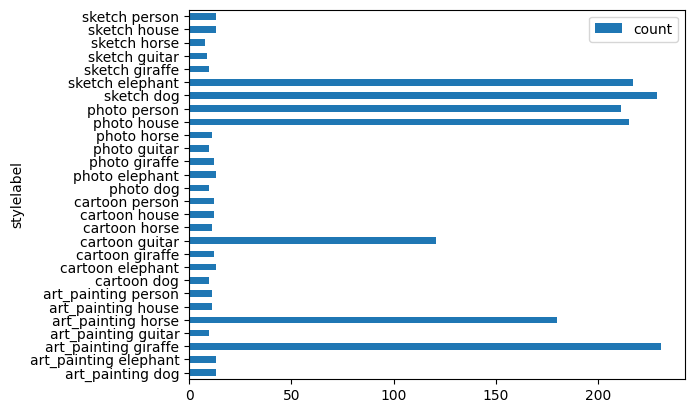

In [ ]:
# train dataset histogram
df = part2_tally_samples(train_ds)
df["stylelabel"] = df["style"] + " " + df["label"]
df.plot(kind ='barh', x = 'stylelabel', y = 'count')

Compare this to the test dataset:

In [ ]:
part2_tally_samples(test_ds)

,style,label,count
0,art_painting,dog,119
1,art_painting,elephant,89
2,art_painting,giraffe,110
3,art_painting,guitar,82
4,art_painting,horse,90
5,art_painting,house,110
6,art_painting,person,96
7,cartoon,dog,95
8,cartoon,elephant,83
9,cartoon,giraffe,109


<Axes: ylabel='stylelabel'>

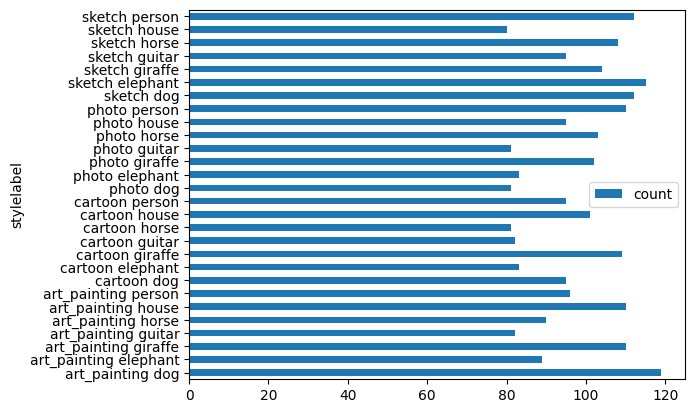

In [ ]:
# test dataset histogram
df2 = part2_tally_samples(test_ds)
df2["stylelabel"] = df2["style"] + " " + df2["label"]
df2.plot(kind = 'barh', x = 'stylelabel', y = 'count')

### Main Implementation

The architecture of the classification model is also a VGG19 model, adapted for multiclass classification.

In [ ]:
# [C9]
def build_vgg19_classifier(input_shape, num_class):
    # Create vgg19 structure
    model = Sequential()

    # table 1 layers
    model.add(Conv2D(64, (3, 3), activation = 'relu', padding = 'same', input_shape = input_shape, name = 'conv1_1'))
    model.add(Conv2D(64, (3, 3), activation = 'relu', padding = 'same', name = 'conv1_2'))
    model.add(MaxPooling2D((2, 2), strides=(2, 2), name='pool1'))

    model.add(Conv2D(128, (3, 3), activation = 'relu', padding = 'same', name = 'conv2_1'))
    model.add(Conv2D(128, (3, 3), activation = 'relu', padding = 'same', name = 'conv2_2'))
    model.add(MaxPooling2D((2, 2), strides = (2, 2), name = 'pool2'))

    model.add(Conv2D(256, (3, 3), activation = 'relu', padding = 'same', name = 'conv3_1'))
    model.add(Conv2D(256, (3, 3), activation = 'relu', padding = 'same', name = 'conv3_2'))
    model.add(Conv2D(256, (3, 3), activation = 'relu', padding = 'same', name = 'conv3_3'))
    model.add(Conv2D(256, (3, 3), activation = 'relu', padding = 'same', name = 'conv3_4'))
    model.add(MaxPooling2D((2, 2), strides = (2, 2), name = 'pool3'))

    model.add(Conv2D(512, (3, 3), activation = 'relu', padding = 'same', name = 'conv4_1'))

    # table 3 layers
    model.add(GlobalAveragePooling2D(input_shape = input_shape, name = 'global_pool'))
    model.add(Dense(1024, activation = 'relu', name ='dense1'))
    model.add(Dense(1024, activation = 'relu', name ='dense2'))
    model.add(Dense(512, activation = 'relu', name='dense3'))
    model.add(Dense(num_class, activation = 'softmax', name = 'dense4'))

    model.summary()

    return model

In [ ]:
# [This part is not graded but is required for successful completion of other tasks]
def part2_setup(LOAD_PATH = None):
    INPUT_SHAPE = (None, None, 3)

    # Build model
    # .unique() labels in train and test datasets
    model = build_vgg19_classifier(INPUT_SHAPE, 7)

    # Get Loss
    loss_fn = tf.keras.losses.CategoricalCrossentropy()

    if LOAD_PATH:
        model.load_weights(LOAD_PATH)

    return model, loss_fn

model2, loss2 = part2_setup()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1_1 (Conv2D)            (None, None, None, 64)    1792      
                                                                 
 conv1_2 (Conv2D)            (None, None, None, 64)    36928     
                                                                 
 pool1 (MaxPooling2D)        (None, None, None, 64)    0         
                                                                 
 conv2_1 (Conv2D)            (None, None, None, 128)   73856     
                                                                 
 conv2_2 (Conv2D)            (None, None, None, 128)   147584    
                                                                 
 pool2 (MaxPooling2D)        (None, None, None, 128)   0         
                                                                 
 conv3_1 (Conv2D)            (None, None, None, 256)  

### Training the model with the given dataset

In [ ]:
# [C10]
def part2_train(model, dataset, loss_fn, n_epochs = 100, save_interval = 10, save_path=None, load_path=None):
    # Initialize the Optimizer
    # optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4, weight_decay = 5e-5)
    optimizer = tf.keras.optimizers.Adam(learning_rate = 1e-4)

    # Calculate the number of batches per epoch
    n_batches = len(dataset)// dataset.batch_size

    # Initialize other things
    process = psutil.Process(os.getpid())

    # Load weights if provided
    if load_path:
        model.load_weights(load_path)

    # Run for n epochs
    for e in range(1, n_epochs+1):
        pbar = tqdm(total=n_batches)
        # Reset Dataset Iterators
        dataset.reset_pointer()

        # Define Loss Metrics. To be updated in each batch
        losses = {"cross-entropy": 0.0}

        # Run for all batches
        for i in range(n_batches):
            # Fetch Training Batches
            batch = dataset.get_batch()
            batchx, batchy = batch

            # Execute Batch Training
            with tf.GradientTape() as tape:
                predict = model(batchx)
                loss = loss_fn(batchy, predict)

            grads = tape.gradient(loss, model.trainable_weights)
            optimizer.apply_gradients(zip(grads, model.trainable_weights))

            # Update Loss Metrics
            loss_updated = losses["cross-entropy"] * i + loss.numpy()
            losses["cross-entropy"] = loss_updated/ (i+1)

            # Visualize loss during training
            string = "".join([f"{key} loss: {value:.3f}\t" for key, value in losses.items()])
            pbar.set_description(f"Epoch {e}/{n_epochs}\t" + string)
            pbar.update(1)

        # In case the session ends before the training is done, perform save the model from time to time:
        if e % save_interval == 0:
            if save_path:
                model.save(save_path)


In [ ]:
# Train the model
PART2_SAVE_PATH = "/content/drive/MyDrive/COMP4211_Models/modelpart2.h5"
PART2_LOAD_PATH = "/content/drive/MyDrive/COMP4211_Models/modelpart2.h5"

model2, loss2 = part2_setup()
train_ds = data_pacs_train


Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1_1 (Conv2D)            (None, None, None, 64)    1792      
                                                                 
 conv1_2 (Conv2D)            (None, None, None, 64)    36928     
                                                                 
 pool1 (MaxPooling2D)        (None, None, None, 64)    0         
                                                                 
 conv2_1 (Conv2D)            (None, None, None, 128)   73856     
                                                                 
 conv2_2 (Conv2D)            (None, None, None, 128)   147584    
                                                                 
 pool2 (MaxPooling2D)        (None, None, None, 128)   0         
                                                                 
 conv3_1 (Conv2D)            (None, None, None, 256)  

In [ ]:
# keeping commented to prevent rerunning
# part2_train(model2, train_ds, loss2, n_epochs=1, save_interval = 1, save_path=PART2_SAVE_PATH)

  0%|          | 0/27 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# keeping commented to prevent rerunning
# part2_train(model2, train_ds, loss2, n_epochs=10, save_interval = 10, save_path=PART2_SAVE_PATH, load_path=PART2_LOAD_PATH)

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# keeping commented to prevent rerunning
# part2_train(model2, train_ds, loss2, n_epochs=9, save_interval = 9, save_path=PART2_SAVE_PATH, load_path=PART2_LOAD_PATH)

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Testing

We can now test our first classifier model with the test dataset (maybe train dataset too, to make sure the training went properly).

Calculate the accuracy of the model, as well as the confusion matrix to for a clearer idea on the model's performance:

In [ ]:
# [C11]
def part2_evaluate(model, dataset):
    n_batches = len(dataset)// dataset.batch_size
    confusion_matrix = np.zeros((7, 7), dtype = int)
    total_samples = 0
    correct_predictions = 0

    for i in range(n_batches):
        batch = dataset.get_batch()
        if batch is None:
            break
        batchx, batchy = batch

        predict = model(batchx)
        pred_labels = tf.argmax(predict, axis = 1)
        actual_labels = tf.argmax(batchy, axis = 1)

        for actual_labels, pred_label in zip(actual_labels, pred_labels):
            confusion_matrix[actual_labels, pred_label] += 1

        correct_predictions += np.sum(pred_labels == actual_labels)
        total_samples += len(batchy)

    accuracy = correct_predictions/total_samples

    return accuracy, confusion_matrix

In [ ]:
model2.load_weights(PART2_SAVE_PATH)

# train dataset evaluation
train_accuracy, train_confusion_matrix = part2_evaluate(model2, train_ds)

# test dataset evaluation
test_accuracy, test_confusion_matrix = part2_evaluate(model2, test_ds)

print("Training dataset accuracy:", train_accuracy)
print("Confusion matrix for training dataset:")
print(train_confusion_matrix)

print("\nTest dataset accuracy:", test_accuracy)
print("Confusion Matrix for test dataset:")
print(test_confusion_matrix)

Training dataset accuracy: 0.15679012345679014
Confusion matrix for training dataset:
[[231  27   0   0   3   0   0]
 [  9 244   0   0   0   0   0]
 [  6   0 250   1   0   1   0]
 [  3   0   0 137   7   0   1]
 [  6   1   0   0 203   0   0]
 [  0   1   1   0   1 244   0]
 [  3   8   0   0   0   2 230]]

Test dataset accuracy: 0.14925925925925926
Confusion Matrix for test dataset:
[[118  37  52  19 146  23  10]
 [ 42 160  50   5  71  25  13]
 [ 77  15 189  33  39  59  10]
 [ 34  17  27 159  76   8  16]
 [102  21  13  17 182  31  12]
 [ 11  25  47   7  26 258   7]
 [ 38  92  48  20  55  26 132]]


### Data Augmentation with Style Transfer

In [ ]:
# [C12]
def part2_transfer(model, dataset, content_idx, style_idx, alpha):
    # Tip: A large part of part1_inference can be applied here.
    # Get content image filename and style from dataset
    style_filename = dataset.data.iloc[style_idx]['file_name']
    style_image = get_image(style_filename, resize=True)
    style_tensor = preprocess(style_image)

    content_filename = dataset.data.iloc[content_idx]['file_name']
    content_image = get_image(content_filename, resize=True)
    content_tensor = preprocess(content_image)

    alpha_tensor = tf.convert_to_tensor([alpha], dtype=tf.float32)

    output_raw, _ = model([content_tensor[None, ...], style_tensor[None, ...], alpha_tensor[None, ...]])

    # output_array = output_raw.squeeze()
    y = deprocess(output_raw.numpy().squeeze())
    img = array_to_img(y)

    return img

In [ ]:
# [C12]
def part2_augment(part1_load_path, dataset, output_tsv, output_dir, samples_per_pair = 50, alpha = ALPHA, random_state = 4211):
    # We don't want to reload the model for every single sample,
    # so we load one here and pass it to the transfer function:
    model = load_model(part1_load_path, custom_objects={'AdaIN': AdaIN})

    # Get label and style samples to transfer from
    # These are expected to be in the form of
    # { "(label/style name)": [(list of indices in the dataset that corresponds to the label/style)], ... }
    # Tip: If you can have a pandas Dataframe from the dataset, you can use groupby(...).indices here.
    labeldict = {}
    styledict = {}
    for idx in range(len(dataset)):
        label = dataset.data.iloc[idx]['label']
        style = dataset.data.iloc[idx]['style']

        if label not in labeldict:
            labeldict[label] = []

        if style not in styledict:
            styledict[style] = []
        labeldict[label].append(idx)
        styledict[style].append(idx)

    # Generate random samples
    rng = np.random.default_rng(random_state)
    derived_tsv = "" # For usage in ClassificationDataset
    pair_set = set() # To prevent generating duplicates
    for label, label_idxs in labeldict.items():
        for style, style_idxs in styledict.items():
            for _ in range(samples_per_pair):
                pair = None
                while not pair or pair in pair_set:
                    pair = rng.choice(label_idxs), rng.choice(style_idxs)
                pair_set.add(pair)

                # Generate 1 sample
                img = part2_transfer(model, dataset, pair[0], pair[1], alpha)

                # Make up a name for the same sample. Don't repeat the names!
                derived_name = f"{label}_{style}_{pair[0]}_{pair[1]}.jpg"
                # Add an entry to the TSV file. Follow the format of "train-data.tsv" and "test-data.tsv"!
                derived_entry = f"{derived_name}\t{style}\t{label}\n"

                # Save the image in the given folder
                img.save(os.path.join(output_dir, derived_name))
                # Add entry to the TSV to be written
                derived_tsv += derived_entry

    # Write the entries into the given file name
    with open(output_tsv, "w") as f:
        f.write(derived_tsv)


In [ ]:
PART1_MODEL_PATH = '/content/drive/MyDrive/COMP4211_Models/model.h5'
ALPHA = 0.75
OUTPUT_TSV = "/content/drive/MyDrive/COMP4211_Models/classify/derived-data.tsv"
OUTPUT_DIR = "/content/drive/MyDrive/COMP4211_Models/classify/derived-files"

# Before running the augmentation, it is a good idea to prepare an empty directory for the generated outputs:
def part2_cleanup_augments(output_dir):
    !rm -rf "$output_dir"
    !mkdir -p "$output_dir"

In [ ]:
!cat "$OUTPUT_TSV"

guitar_cartoon_1192_482.jpg	cartoon	guitar
guitar_cartoon_366_412.jpg	cartoon	guitar
guitar_cartoon_1355_1581.jpg	cartoon	guitar
guitar_cartoon_1137_136.jpg	cartoon	guitar
guitar_cartoon_75_190.jpg	cartoon	guitar
guitar_cartoon_921_253.jpg	cartoon	guitar
guitar_cartoon_628_653.jpg	cartoon	guitar
guitar_cartoon_466_1623.jpg	cartoon	guitar
guitar_cartoon_453_1297.jpg	cartoon	guitar
guitar_cartoon_239_1529.jpg	cartoon	guitar
guitar_cartoon_334_749.jpg	cartoon	guitar
guitar_cartoon_723_1096.jpg	cartoon	guitar
guitar_cartoon_999_1096.jpg	cartoon	guitar
guitar_cartoon_632_999.jpg	cartoon	guitar
guitar_cartoon_1055_1524.jpg	cartoon	guitar
guitar_cartoon_835_250.jpg	cartoon	guitar
guitar_cartoon_1136_1191.jpg	cartoon	guitar
guitar_cartoon_585_1356.jpg	cartoon	guitar
guitar_cartoon_334_1512.jpg	cartoon	guitar
guitar_cartoon_749_136.jpg	cartoon	guitar
guitar_sketch_758_238.jpg	sketch	guitar
guitar_sketch_124_53.jpg	sketch	guitar
guitar_sketch_1295_980.jpg	sketch	guitar
guitar_sketch_992_1610.jpg

In [ ]:
# Generate the dataset:
part2_cleanup_augments(OUTPUT_DIR)
part2_augment(PART1_MODEL_PATH, train_ds, OUTPUT_TSV, OUTPUT_DIR, samples_per_pair = 20, alpha = ALPHA, random_state = 4211)

### Training the model with an augmented dataset

After generating the images we can produce a new, augmented dataset for retraining. We would like to add the data to the existing train dataset, in order to have a more balanced distribution between different styles and categories.

In [ ]:
def part2_prepare_aug_dataset():
    #####
    # MODIFY SETTINGS HERE
    #####
    BATCH_SIZE = 64
    TRAIN_DS_PATH = os.path.join(pacs_path, "train-files/")
    TRAIN_TSV_PATH = os.path.join(pacs_path, "train-data.tsv")
    DERIVED_DS_PATH = "/content/drive/MyDrive/COMP4211_Models/classify/derived-files"
    DERIVED_TSV_PATH = "/content/drive/MyDrive/COMP4211_Models/classify/derived-data.tsv"

    train2_ds = ClassificationDataset(TRAIN_TSV_PATH, TRAIN_DS_PATH, batch_size = BATCH_SIZE)
    train2_ds.add_data(DERIVED_TSV_PATH, DERIVED_DS_PATH)

    return train2_ds

train2_ds = part2_prepare_aug_dataset()

We can confirm the augmentation by looking at its distribution:

In [ ]:
part2_tally_samples(train2_ds)

Now we can train another classifier using the augmented data:

In [ ]:
PART2_SAVE_PATH_2 = "/content/drive/MyDrive/COMP4211_Models/classify-augmentation.h5"

part2_train(model2, train_ds, loss2, n_epochs=10, save_interval = 100, save_path=PART2_SAVE_PATH, load_path=PART2_LOAD_PATH)

Test the model for any performance changes. After that, feel free to explore on more ways to improve the model!